In [83]:
from pyTsetlinMachine.tm import MultiClassTsetlinMachine
import numpy as np

In [84]:
# np.where(X_train > 0)

In [85]:
# X_train.reshape((X_train.shape[0], 28*28))

In [86]:
# np.where(X_train.reshape((X_train.shape[0], 28*28)) > 75, 1, 0) 

In [87]:
# img0_path = filenames[0]
# img0_pathdd

### Tzetlin

In [88]:
%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [114]:
import pandas as pd
import os
import cv2
import numpy as np
from pyTsetlinMachine.tm import MultiClassTsetlinMachine
from time import time
from PIL import Image
from sklearn.model_selection import train_test_split

In [115]:
from tzetlin import (filename_to_bin_img_array, get_img_array, filter_uneven_shapes,
                     load_lesion_df, get_all_imgs_filenames_from_dir_list, filter_non_lesion_entries, 
                     get_lesion_filenames_list,
                     get_Y_train, split_lesions_present_absent,
                     find_duplicates)

## 1. Dataset pruned

In [91]:
PRUNED_DATASET_DIR = "data/Dataset-pruned"
PRUNED_IMGS_DIR = PRUNED_DATASET_DIR + "/base_images"

In [179]:
df = load_lesion_df()
print(df.shape)

lesions_present_df, lesions_absent_df = split_lesions_present_absent(df)

lesion_filenames = get_lesion_filenames_list(df)
print(len(lesion_filenames))

lesions_present_df_filenames = get_lesion_filenames_list(lesions_present_df)
# lesions_present_set = set(lesions_present_df_filenames)
print(len(lesions_present_df_filenames))
# print(len(lesions_present_set))
# len(find_duplicates(lesions_present_df_filenames))

lesions_absent_df_filenames = get_lesion_filenames_list(lesions_absent_df)
# lesions_absent_set = set(lesions_absent_df_filenames)
print(len(lesions_absent_df_filenames))
# print(len(lesions_absent_set))
# len(find_duplicates(lesions_absent_df_filenames))

# Filenames from dir
all_filenames = get_all_imgs_filenames_from_dir_list(PRUNED_IMGS_DIR)
# all_filenames_set = set(all_filenames)
len(all_filenames)

(1149, 31)
1149
620
529


931

In [180]:
dir_lesions_present = []
dir_lesions_absent = []
other = []

for f in all_filenames:
    if f in lesions_present_df_filenames:
        dir_lesions_present.append(f)
    elif f in lesions_absent_df_filenames:
        dir_lesions_absent.append(f)
    else:
        other.append(f)

In [181]:
len(other)

57

In [182]:
dir_lesions_absent += other

In [96]:
# for df_present in lesions_present_df_filenames:
#     if df_present not in dir_lesions_present:
#         dir_lesions_present.append(df_present)

In [97]:
# for df_absent in lesions_absent_df_filenames:
#     if df_absent not in dir_lesions_absent:
#         dir_lesions_absent.append(df_absent)

In [183]:
all_imgs = dir_lesions_present + dir_lesions_absent
len(all_imgs)

Y_train = [1]*len(dir_lesions_present) + [0]*len(dir_lesions_absent)
len(Y_train)

931

In [184]:
imgs_frames = []

for f in all_imgs:
    base = f.replace('.png','')
    img_id, frame = base.split('_')
    imgs_frames.append((img_id, frame))
len(imgs_frames)

931

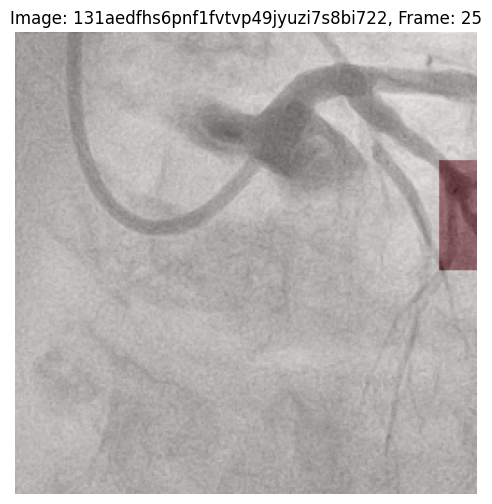

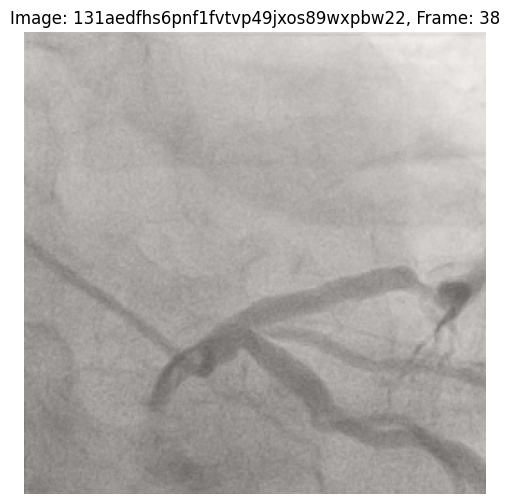

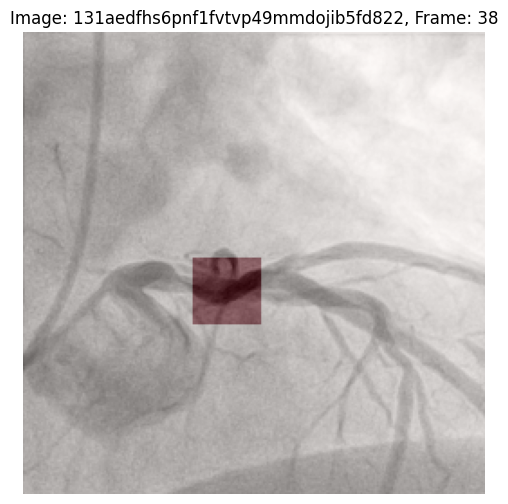

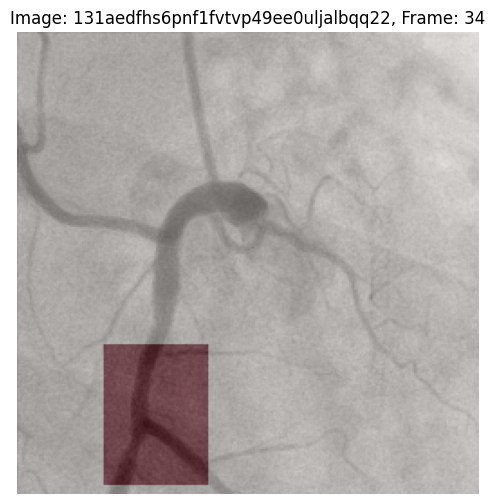

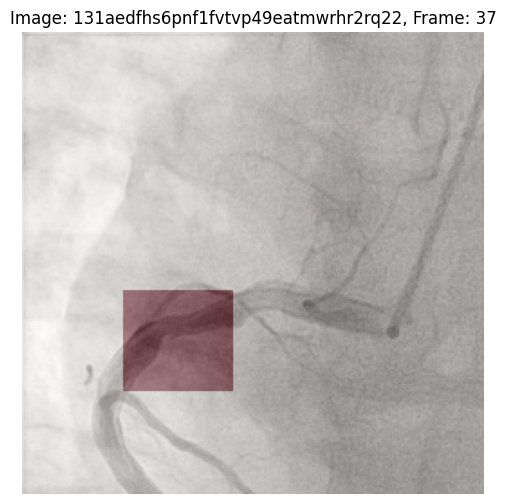

...

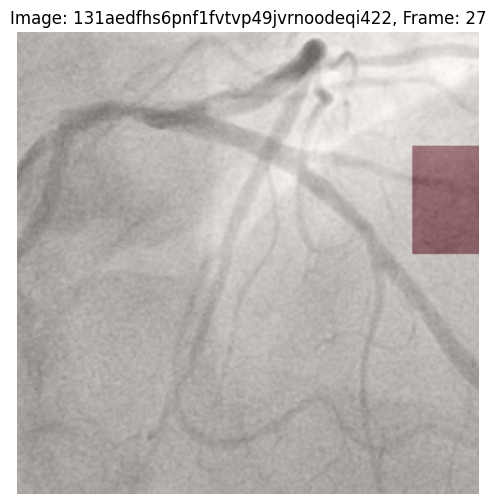

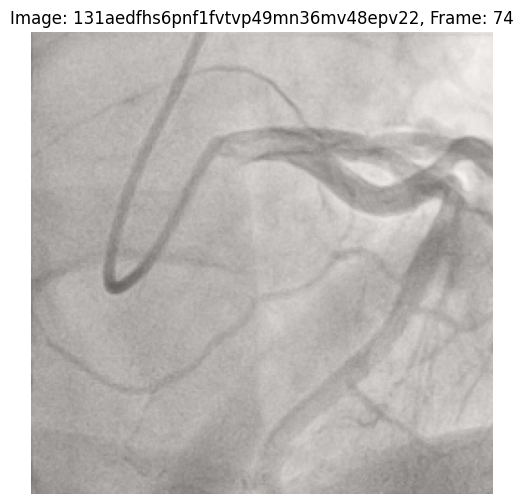

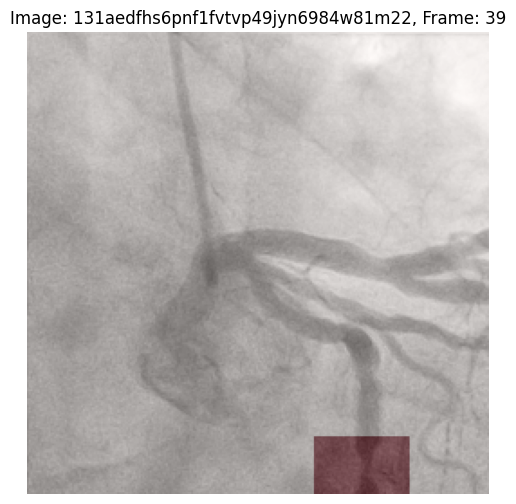

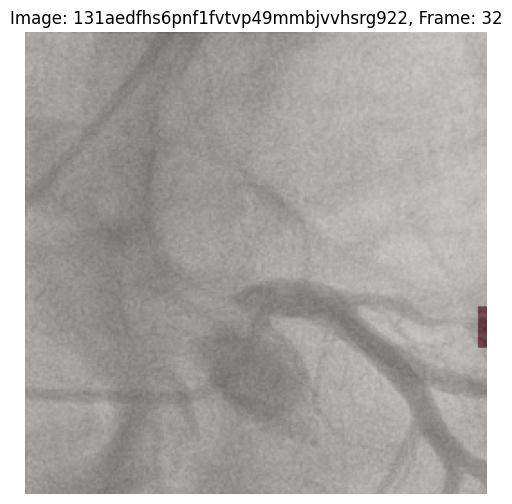

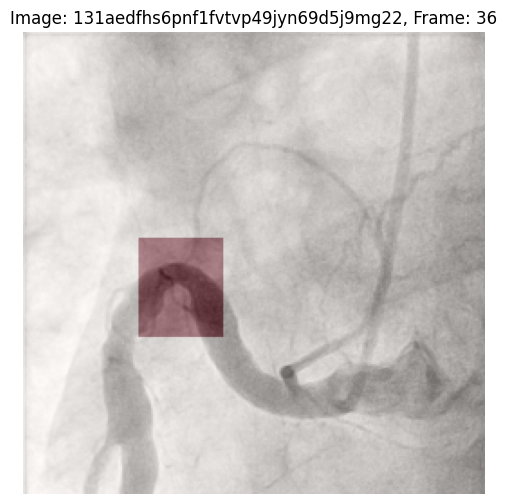

In [301]:
import matplotlib.pyplot as plt
import numpy as np
from PIL import Image


DEFAULT_IMG_SIZE = (512, 512)

# Example: imgs_frames = list of (img_id, frame)
# original_images_dir = directory where images are stored
# lesion_masks = list of binary masks corresponding to each image in imgs_frames

n_show = 100  # number of images to visualize

for i, (img_id, frame) in enumerate(imgs_frames[:n_show]):
    # Load original image
    img_path = os.path.join(PRUNED_IMGS_DIR, f"{img_id}_{frame}.png")
    img = Image.open(img_path).convert("L")  # grayscale
    img = img.resize(DEFAULT_IMG_SIZE, Image.NEAREST)
    img_arr = np.array(img)

    # Get corresponding lesion mask
    mask = lesion_masks[i]

    # Display
    plt.figure(figsize=(6,6))
    plt.imshow(img_arr, cmap='gray')
    
    # Overlay lesion mask in red with transparency
    plt.imshow(mask, cmap='Reds', alpha=0.4)
    
    plt.title(f"Image: {img_id}, Frame: {frame}")
    plt.axis("off")
    plt.show()


In [185]:
img_size = (256, 256)
lesion_masks = []


for img_id, frame in imgs_frames:
    frame = int(frame)
    row = df[(df['image_id'] == img_id) & (df['frame'] == frame)]

    if row.empty:
        # print(f"WARNING: No entry in df for {img_id}, frame {frame}")
        lesion_masks.append(np.zeros(img_size, dtype=np.uint8))
        continue
    elif pd.isna(row.iloc[0]['lesion_id']):
        # print(f"WARNING: No lesion for {img_id}, frame {frame}")
        lesion_masks.append(np.zeros(img_size, dtype=np.uint8))
        continue

    lesion_x = int(row.iloc[0]['lesion_x'])
    lesion_y = int(row.iloc[0]['lesion_y'])
    lesion_width = int(row.iloc[0]['lesion_width'])
    lesion_height = int(row.iloc[0]['lesion_height'])

    lesion_mask = np.zeros(img_size, dtype=np.uint8)
    lesion_mask[lesion_y:lesion_y+lesion_height, lesion_x:lesion_x+lesion_width] = 1

    lesion_masks.append(lesion_mask)

lesion_masks = np.array(lesion_masks)
len(lesion_masks)

931

In [186]:
all_imgs = [PRUNED_IMGS_DIR + "/" + img for img in all_imgs]

In [188]:
img_array = get_img_array(all_imgs, size=(256, 256))

In [189]:
imgs_filtered = filter_uneven_shapes(img_array, img_size_standard=(256, 256))

In [190]:
# lesion_trainer = LesionTzetlinTrainer()
# dataset_dir = lesion_trainer.base_images_dir          # change to your dataset path
# img_size = (28,28)               # you can change this
# X, y, class_to_idx = load_image_folder(dataset_dir, size=img_size)
# print("Loaded", X.shape, "labels:", np.unique(y))

# train/test split
X = imgs_filtered
y = Y_train
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, stratify=y, random_state=42)

# Convert to types expected by pyTsetlinMachine (0/1 uint8)
X_train = X_train.astype(np.uint8)
X_test  = X_test.astype(np.uint8)

In [29]:
# # instantiate Convolutional TM
# # number_of_clauses, T, s, patch_dim
# # tm = MultiClassConvolutionalTsetlinMachine2D(number_of_clauses=2000,
# #                                                 T=50*100,   # adjust
# #                                                 s=5.0,
# #                                                 patch_dim=(8,8),
# #                                                 weighted_clauses=True)

# tm = MultiClassTsetlinMachine(number_of_clauses=2000,
#                                                 T=50*100,   # adjust
#                                                 s=5.0,
#                                                 # patch_dim=(8,8),
#                                                 weighted_clauses=True)

# # train
# epochs = 100
# t0 = time()
# tm.fit(X_train, y_train, epochs=epochs)
# t1 = time()
# print(f"Training done in {t1-t0:.1f}s")

In [30]:
# # predict & evaluate
# y_pred = tm.predict(X_test)
# acc = np.mean(y_pred == y_test)
# print(f"Test accuracy: {acc*100:.2f}%")

# # save state (optional)
# state = tm.get_state()   # you can later set_state(state)
# print("Saved TM state (length):", len(state))


### MultiClassConvolutionalTsetlinMachine2D

In [103]:
from pyTsetlinMachine.tm import MultiClassConvolutionalTsetlinMachine2D
from time import time

In [ ]:
# ctm = MultiClassConvolutionalTsetlinMachine2D(40, 60, 3.9, (2,2), boost_true_positive_feedback=0)

# fit_start = time()
# ctm.fit(X_train, Y_train, epochs=200)
# fit_end = time()
# print("Training time:", fit_end - fit_start)


In [38]:
# pred_start = time()
# y_pred = ctm.predict(X_test)
# pred_end = time()
# print("Prediction Time:", pred_end - pred_start)

Prediction Time: 13.819018125534058


In [39]:
# print("Accuracy:", 100*(y_pred == y_test).mean())

Accuracy: 57.75401069518716


### Patches

In [104]:
from sklearn.feature_extraction.image import extract_patches_2d

In [199]:
import numpy as np
from sklearn.feature_extraction.image import extract_patches_2d, reconstruct_from_patches_2d
from pyTsetlinMachine.tm import MultiClassTsetlinMachine

patch_size = (8, 8)
max_patches_per_image = 100  # to control memory

X_patches_list = []
y_labels_list = []

images = imgs_filtered
masks = lesion_masks

for img, mask in zip(images, masks):
    # Extract random patches from this image (if more patches than max_pathes)
    X_patches = extract_patches_2d(img, patch_size) #, max_patches=max_patches_per_image)
    Y_patches = extract_patches_2d(mask, patch_size) #, max_patches=max_patches_per_image)

    # Label each patch: 1 if majority pixels are lesion
    y_labels = (Y_patches.mean(axis=(1,2)) > 0.5).astype(int)
    
    X_patches_list.append(X_patches)
    y_labels_list.append(y_labels)

In [209]:
# Combine all patches from all images
X_all = np.concatenate(X_patches_list, axis=0)
y_all = np.concatenate(y_labels_list, axis=0)

In [302]:
import numpy as np
from sklearn.feature_extraction.image import extract_patches_2d, reconstruct_from_patches_2d
from pyTsetlinMachine.tm import MultiClassTsetlinMachine

X_train_imgs, X_test_imgs, y_train_masks, y_test_masks = train_test_split(
    imgs_filtered, lesion_masks, test_size=0.2, random_state=42
)

patch_size = (8, 8)
max_patches_per_image = 50  # to control memory

X_train_patches_list = []
y_train_patches_list = []

# images = imgs_filtered
# masks = lesion_masks

for img, mask in zip(X_train_imgs, y_train_masks):
    # Extract random patches from this image (if more patches than max_pathes)
    X_patches = extract_patches_2d(img, patch_size, max_patches=max_patches_per_image)
    Y_patches = extract_patches_2d(mask, patch_size, max_patches=max_patches_per_image)
    
    # Label each patch: 1 if majority pixels are lesion
    y_labels = (Y_patches.mean(axis=(1,2)) > 0.5).astype(int)
    
    X_train_patches_list.append(X_patches)
    y_train_patches_list.append(y_labels)

# Combine all patches from all images
X_train_all = np.concatenate(X_train_patches_list, axis=0)
y_train_all = np.concatenate(y_train_patches_list, axis=0)


# tm = MultiClassTsetlinMachine(
#     number_of_clauses=200,
#     T=500,
#     s=5.0,
#     weighted_clauses=True
# )
ctm = MultiClassConvolutionalTsetlinMachine2D(
    number_of_clauses=2000,
    T=200,
    s=3.9,
    patch_dim=patch_size,
    weighted_clauses=True
)

start_time = time()
ctm.fit(X_train_all, y_train_all, epochs=2000)
end_time = time()
print(f"Training completed in {end_time - start_time:.1f} seconds")

Training completed in 4876.6 seconds


In [ ]:
# import pickle

# # tm = your trained Tsetlin Machine
# with open("tm_model.pkl", "wb") as f:
#     pickle.dump(ctm, f)

In [304]:
X_test_array = np.stack(X_test_imgs, axis=0)  # shape = (n_test, H, W)
y_test_array = np.stack(y_test_masks, axis=0)  # shape = (n_test, H, W)


patch_size = (8, 8)

pred_masks = []
pred_times = []

r = X_test_array.shape[0]
# r = 10

for i in range(r):
    test_img = X_test_array[i]
    
    # Extract patches
    test_patches = extract_patches_2d(test_img, patch_size)
    
    # Predict patches
    start_pred = time()
    y_pred = ctm.predict(test_patches)
    end_pred = time()
    print(f"Prediction time for image {i}: {end_pred - start_pred} seconds")
    pred_times.append(end_pred - start_pred)

    # Convert predicted labels to patches
    pred_patches = np.array([np.full(patch_size, label) for label in y_pred])
    
    # Reconstruct full image mask
    pred_mask = reconstruct_from_patches_2d(pred_patches, test_img.shape)
    pred_masks.append(pred_mask)
    
    # pred_masks.append((pred_mask > 0.5).astype(np.uint8))

pred_masks = np.stack(pred_masks, axis=0)

Prediction time for image 0: 1.5906875133514404 seconds
Prediction time for image 1: 1.5800106525421143 seconds
Prediction time for image 2: 1.5306434631347656 seconds
Prediction time for image 3: 1.5246961116790771 seconds
Prediction time for image 4: 1.5180697441101074 seconds
Prediction time for image 5: 1.5476906299591064 seconds
Prediction time for image 6: 1.503272533416748 seconds
Prediction time for image 7: 1.492661952972412 seconds
Prediction time for image 8: 1.4701151847839355 seconds
Prediction time for image 9: 1.5576581954956055 seconds
Prediction time for image 10: 1.540576457977295 seconds
Prediction time for image 11: 1.5773301124572754 seconds
Prediction time for image 12: 1.5279059410095215 seconds
Prediction time for image 13: -0.9455771446228027 seconds
Prediction time for image 14: 1.5423076152801514 seconds
Prediction time for image 15: 1.5316753387451172 seconds
Prediction time for image 16: 1.4729506969451904 seconds
Prediction time for image 17: 1.50924873352

In [305]:
pred_masks_binary = (pred_masks > 0.5).astype(np.uint8)
pred_masks_binary

array([[[0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        ...,
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0]],

       [[0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        ...,
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0]],

       [[0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        ...,
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0]],

       ...,

       [[0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        ...,
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0]],

       [[0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        ...,
        [0, 0, 0, ..., 

In [291]:
X_test_imgs

array([[[1, 1, 1, ..., 1, 1, 1],
        [1, 1, 1, ..., 1, 1, 1],
        [1, 1, 1, ..., 1, 1, 1],
        ...,
        [0, 0, 0, ..., 1, 1, 1],
        [0, 0, 0, ..., 1, 1, 1],
        [0, 0, 0, ..., 1, 1, 1]],

       [[1, 0, 0, ..., 1, 1, 1],
        [0, 0, 0, ..., 1, 1, 1],
        [0, 0, 0, ..., 1, 1, 1],
        ...,
        [1, 1, 1, ..., 1, 1, 1],
        [1, 0, 1, ..., 1, 1, 1],
        [1, 1, 1, ..., 1, 1, 1]],

       [[0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        ...,
        [0, 0, 0, ..., 1, 1, 1],
        [0, 0, 0, ..., 1, 1, 1],
        [0, 0, 0, ..., 1, 1, 1]],

       ...,

       [[0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        ...,
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0]],

       [[0, 0, 0, ..., 1, 1, 1],
        [0, 0, 0, ..., 1, 1, 1],
        [0, 0, 0, ..., 1, 1, 1],
        ...,
        [0, 0, 0, ..., 

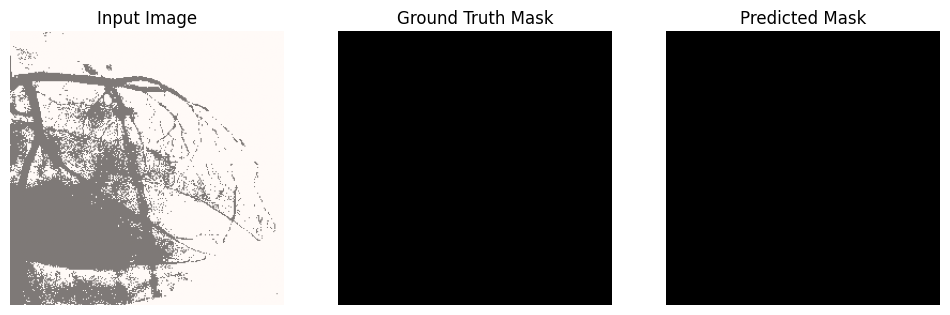

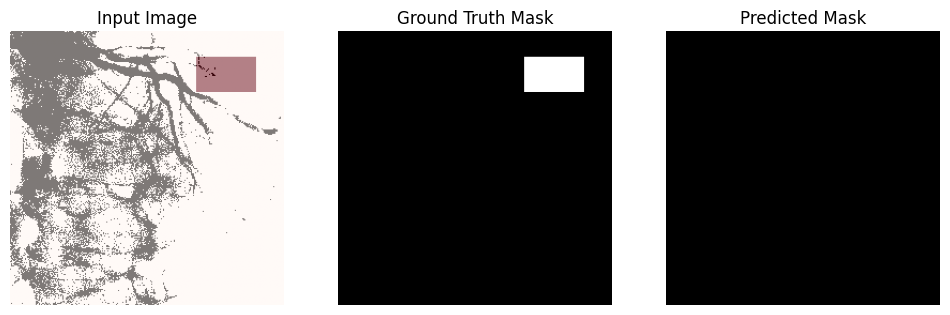

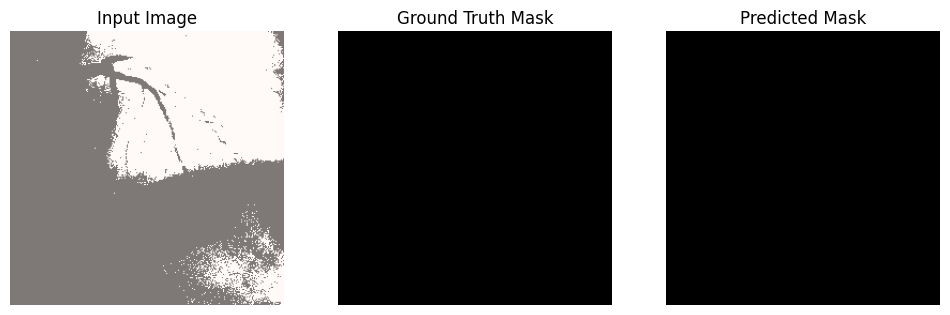

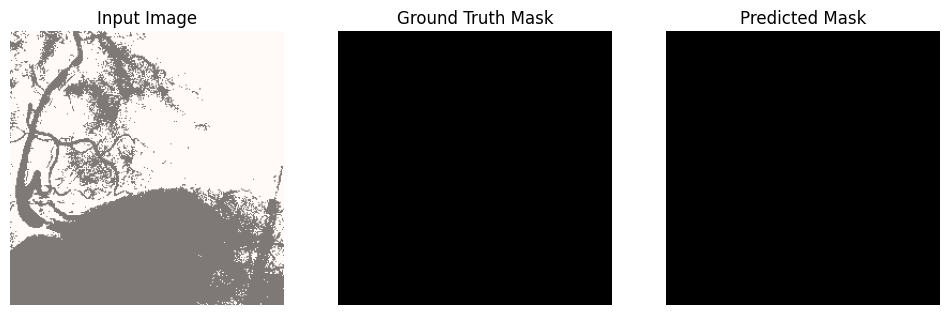

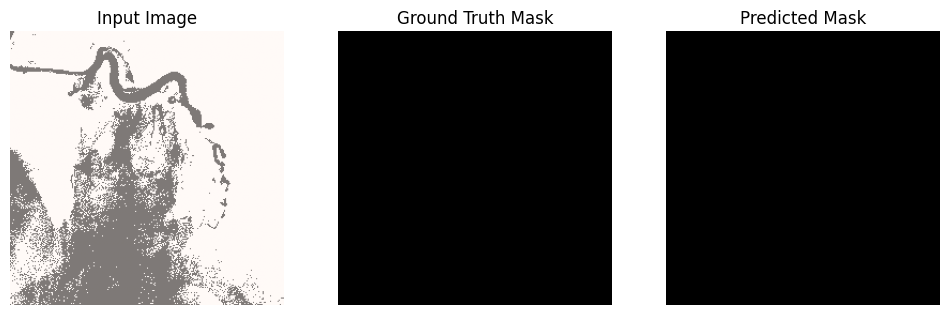

...

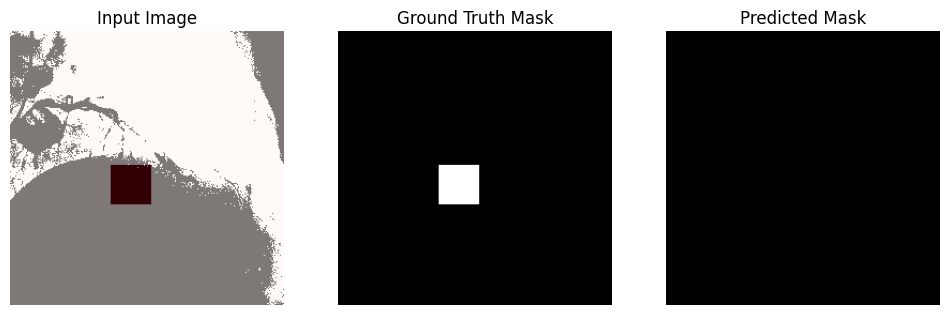

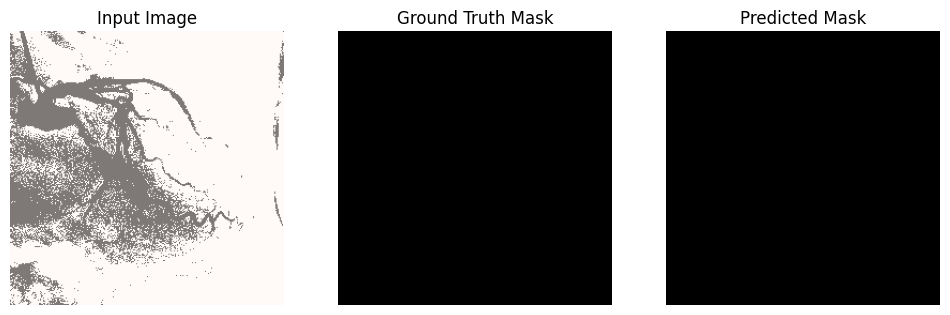

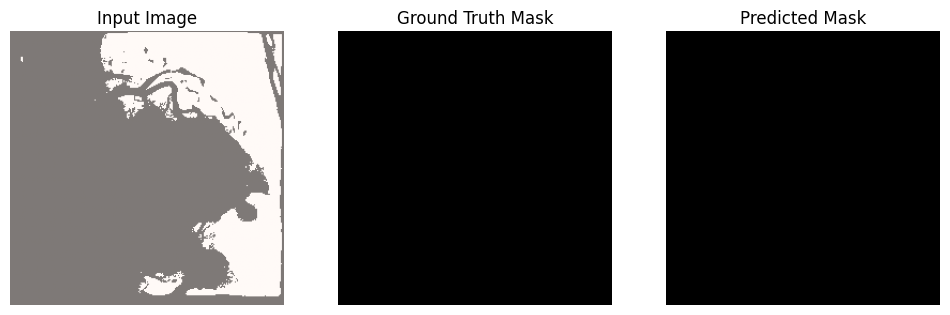

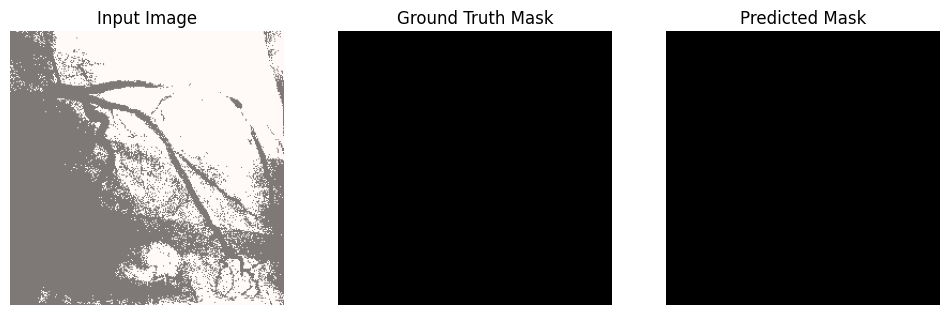

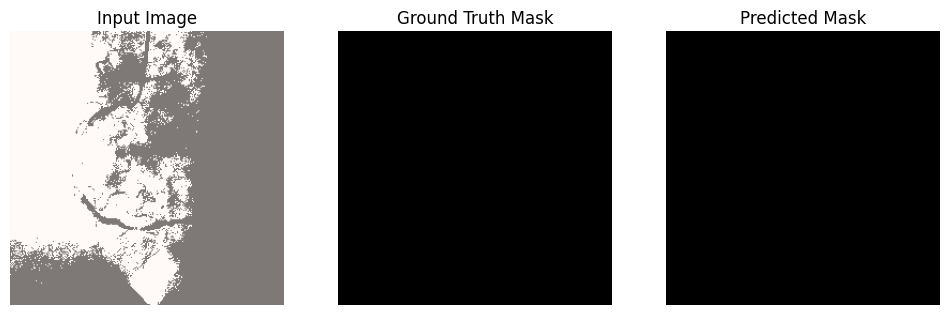

In [306]:
import matplotlib.pyplot as plt

# Suppose X_test_imgs = your test images
# y_test_masks = ground truth masks
# pred_masks = predicted masks (from CTM)

n_show = 187  # number of test images to visualize

for i in range(n_show):
    img = X_test_imgs[i]
    true_mask = y_test_masks[i]
    pred_mask = pred_masks[i]

    plt.figure(figsize=(12, 4))

    # Original image
    plt.subplot(1, 3, 1)
    plt.title("Input Image")
    plt.imshow(img, cmap='gray')
    plt.axis('off')
    plt.imshow(true_mask, cmap='Reds', alpha=0.5)
    plt.axis('off')

    # Ground truth mask
    plt.subplot(1, 3, 2)
    plt.title("Ground Truth Mask")
    plt.imshow(true_mask, cmap='gray')
    plt.axis('off')

    # Predicted mask
    plt.subplot(1, 3, 3)
    plt.title("Predicted Mask")
    plt.imshow(pred_mask, cmap='gray')
    plt.axis('off')

    plt.show()

In [ ]:
# def predict_mask(ctm, test_img, patch_size):
#     test_patches = extract_patches_2d(test_img, patch_size)
#     y_pred = ctm.predict(test_patches)
#     pred_patches = np.array([np.full(patch_size, label) for label in y_pred])
#     pred_mask = reconstruct_from_patches_2d(pred_patches, test_img.shape)
#     return (pred_mask > 0.5).astype(np.uint8)

In [ ]:
# accuracies = []
# for i, test_img in enumerate(X_test_imgs):
#     pred_mask = predict_mask(ctm, test_img, patch_size)
#     true_mask = y_test_masks[i]

#     # Pixel-level accuracy
#     acc = (pred_mask == true_mask).mean()
#     accuracies.append(acc)

#     # # Optional visualization
#     # plt.figure(figsize=(10,3))
#     # plt.subplot(1,3,1)
#     # plt.title("Input Image")
#     # plt.imshow(test_img, cmap='gray')
#     # plt.subplot(1,3,2)
#     # plt.title("Ground Truth Mask")
#     # plt.imshow(true_mask, cmap='gray')
#     # plt.subplot(1,3,3)
#     # plt.title("Predicted Mask")
#     # plt.imshow(pred_mask, cmap='gray')
#     # plt.show()

# print("Mean pixel-wise accuracy on test set:", np.mean(accuracies))

Mean pixel-wise accuracy on test set: 0.9857336850089823


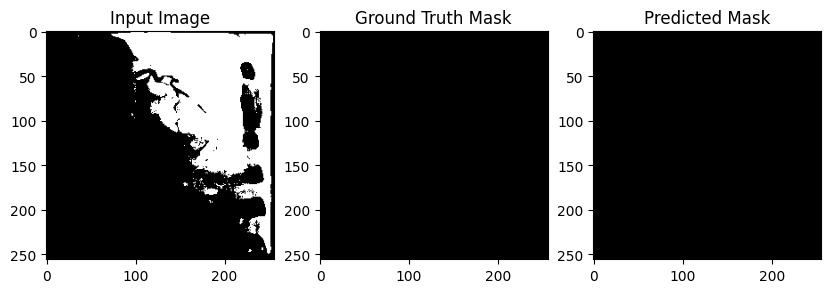

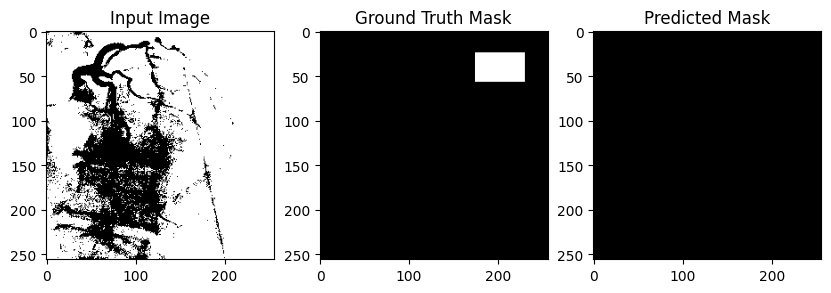

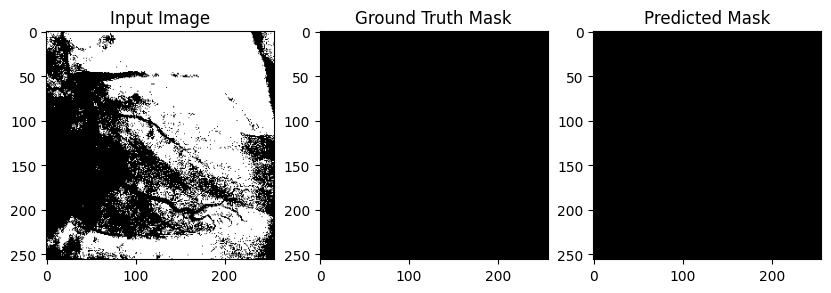

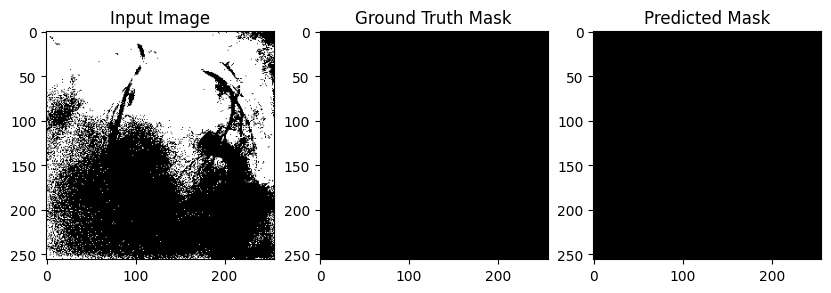

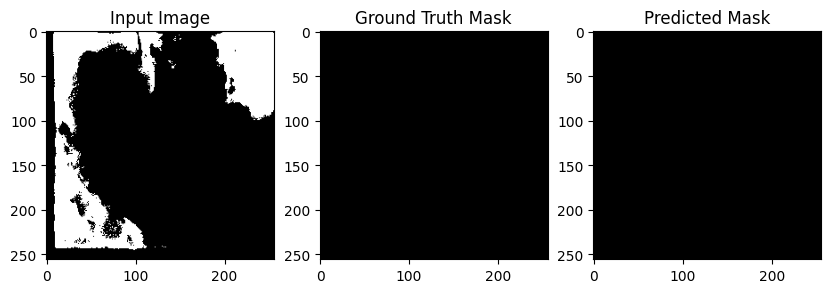

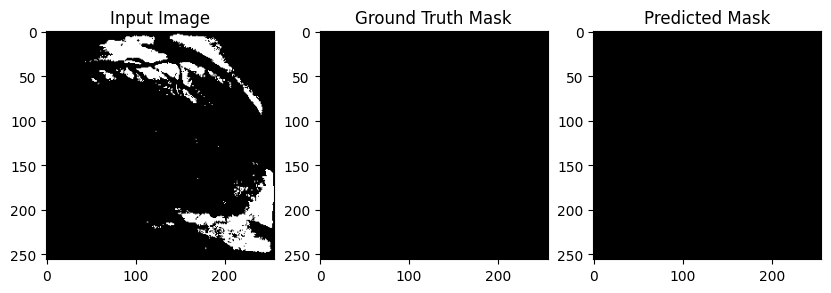

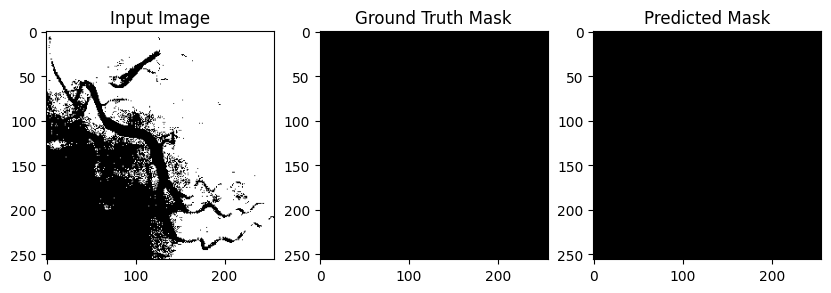

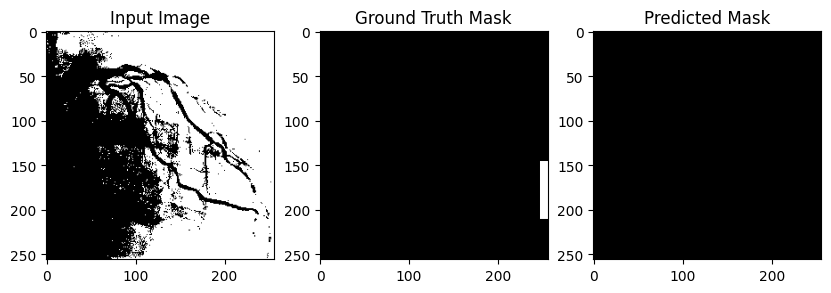

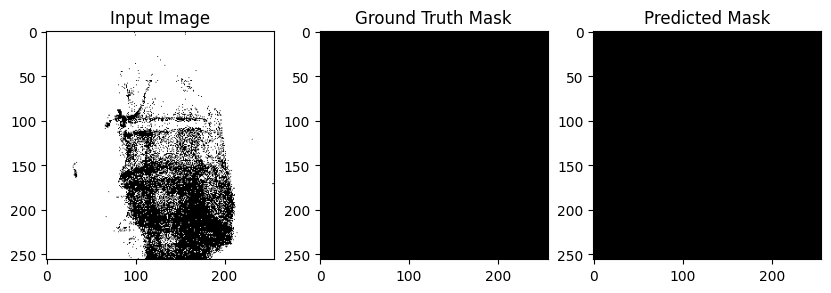

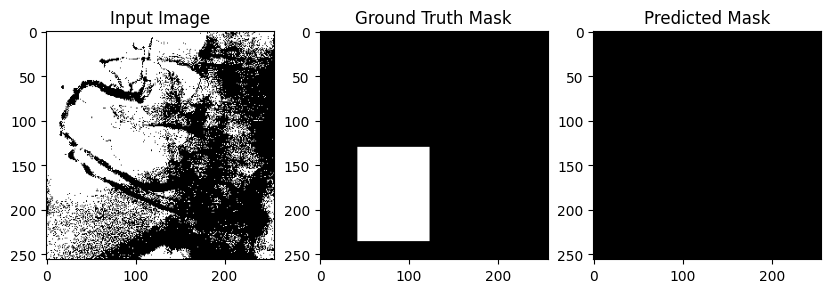

In [233]:
for i, test_image in enumerate(X_test_imgs[90:100]):
    test_mask = y_test_masks[i]
    test_patches = extract_patches_2d(test_image, patch_size)
    y_pred = tm.predict(test_patches)

    pred_patches = np.array([np.full(patch_size, label) for label in y_pred])
    pred_mask = reconstruct_from_patches_2d(pred_patches, test_image.shape)
    binary_pred_mask = (pred_mask > 0.5).astype(np.uint8)

    # Visualize
    plt.figure(figsize=(10,3))
    plt.subplot(1,3,1)
    plt.title("Input Image")
    plt.imshow(test_image, cmap='gray')
    plt.subplot(1,3,2)
    plt.title("Ground Truth Mask")
    plt.imshow(test_mask, cmap='gray')
    plt.subplot(1,3,3)
    plt.title("Predicted Mask")
    plt.imshow(binary_pred_mask, cmap='gray')
    plt.show()

In [ ]:
# -----------------------------
# 4️⃣ Predict on test image
# -----------------------------
# Extract overlapping patches
test_patches = extract_patches_2d(test_image, patch_size)
n_test_patches = test_patches.shape[0]

# Flatten patches for TM
X_test_flat = test_patches.reshape(n_test_patches, -1)

# Predict patch labels
y_pred = tm.predict(X_test_flat)

# -----------------------------
# 5️⃣ Expand predictions to patches
# -----------------------------
# Each patch gets an 8x8 filled patch with predicted label
pred_patches_filled = np.array([np.full(patch_size, label) for label in y_pred])

# Reconstruct full predicted mask
pred_mask = reconstruct_from_patches_2d(pred_patches_filled, test_image.shape)

print("Predicted mask shape:", pred_mask.shape)  # (64,64)

In [62]:
import numpy as np
from sklearn.feature_extraction.image import extract_patches_2d, reconstruct_from_patches_2d
from pyTsetlinMachine.tm import MultiClassTsetlinMachine

# -----------------------------
# 1️⃣ Prepare example data
# -----------------------------
# Example test image (64x64 binary)
test_image = np.random.randint(0, 2, (64, 64))

# Example "lesion mask" for training (64x64 binary)
train_image = np.random.randint(0, 2, (64, 64))
train_mask  = np.random.randint(0, 2, (64, 64))

patch_size = (8, 8)
max_patches = 500  # sample patches for training

# -----------------------------
# 2️⃣ Extract training patches
# -----------------------------
X_patches = extract_patches_2d(train_image, patch_size, max_patches=max_patches)
Y_patches = extract_patches_2d(train_mask,  patch_size, max_patches=max_patches)

# Label each patch: 1 if majority pixels = lesion
y_labels = (Y_patches.mean(axis=(1,2)) > 0.5).astype(int)

# Flatten patches for TM input
n_samples, h, w = X_patches.shape
X_flat = X_patches.reshape(n_samples, h*w)

# -----------------------------
# 3️⃣ Train Tsetlin Machine
# -----------------------------
tm = MultiClassTsetlinMachine(
    number_of_clauses=200,
    T=500,
    s=5.0,
    weighted_clauses=True
)

tm.fit(X_flat, y_labels, epochs=50)

# -----------------------------
# 4️⃣ Predict on test image
# -----------------------------
# Extract overlapping patches
test_patches = extract_patches_2d(test_image, patch_size)
n_test_patches = test_patches.shape[0]

# Flatten patches for TM
X_test_flat = test_patches.reshape(n_test_patches, -1)

# Predict patch labels
y_pred = tm.predict(X_test_flat)

# -----------------------------
# 5️⃣ Expand predictions to patches
# -----------------------------
# Each patch gets an 8x8 filled patch with predicted label
pred_patches_filled = np.array([np.full(patch_size, label) for label in y_pred])

# Reconstruct full predicted mask
pred_mask = reconstruct_from_patches_2d(pred_patches_filled, test_image.shape)

print("Predicted mask shape:", pred_mask.shape)  # (64,64)


Predicted mask shape: (64, 64)


In [63]:
pred_mask

array([[          1,           1,           1, ...,     0.66667,         0.5,           1],
       [        0.5,         0.5,     0.66667, ...,     0.66667,         0.5,         0.5],
       [    0.33333,         0.5,     0.55556, ...,     0.66667,     0.66667,     0.66667],
       ...,
       [          0,     0.16667,     0.22222, ...,     0.44444,         0.5,     0.33333],
       [          0,           0,     0.16667, ...,     0.33333,        0.25,           0],
       [          0,           0,     0.33333, ...,     0.66667,         0.5,           0]], shape=(64, 64))

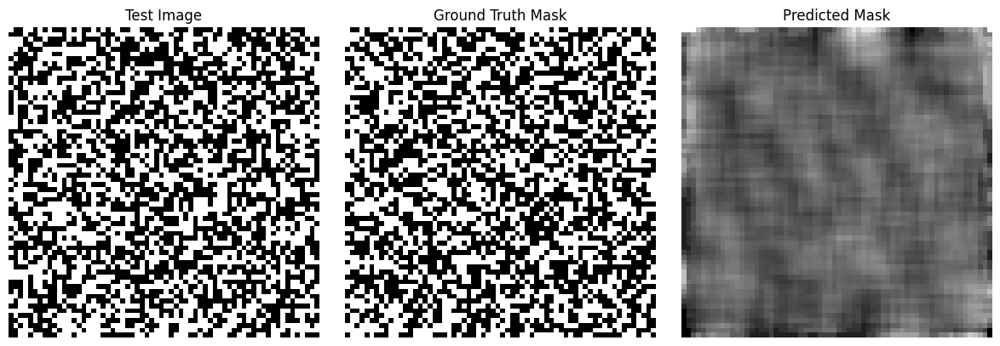

In [64]:
import matplotlib.pyplot as plt

# Assume test_image, train_mask, pred_mask from previous code

plt.figure(figsize=(12,4))

# Original test image
plt.subplot(1,3,1)
plt.imshow(test_image, cmap='gray')
plt.title("Test Image")
plt.axis('off')

# Ground truth lesion mask (for comparison)
plt.subplot(1,3,2)
plt.imshow(train_mask, cmap='gray')
plt.title("Ground Truth Mask")
plt.axis('off')

# Predicted mask
plt.subplot(1,3,3)
plt.imshow(pred_mask, cmap='gray')
plt.title("Predicted Mask")
plt.axis('off')

plt.tight_layout()
plt.show()
